In [1]:
import anndata
import scvelo as scv
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc
import glob, os
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import matplotlib.colors

## plot velocity gene

In [13]:
plot_genes = ['ITGB8', 'ARID3B', 'SHH', 'ARNTL', 'TBXT', 'SLIT2', 'NEDD9', 'SEMA3A', 'SEMA3E', 'SEMA6A', 'SEMA3C', 'CD109']
sample = 'cfs'
input_file = '/storage/holab/linxy/iPSC/veloAE/' + sample + '_seurate_wTrajectory.h5ad'
#input_file = '/home/linxy29/holab/iPSC/veloAE/' + sample + '_seurate_wTrajectory.h5ad'
adata = sc.read_h5ad(input_file)

In [4]:
unsplicedDF = adata.to_df(layer="unspliced")
unsplicedDF['UMAP1'] = adata.obsm['X_umap'][:,0]
unsplicedDF['UMAP2'] = adata.obsm['X_umap'][:,1]
unsplicedDF

Gene,HES4,MXRA8,ENO1,MIR34AHG,FBXO2,NPPB,DHRS3,IFFO2,CAMK2N1,HSPG2,...,GYG2P1,UTY,RPS4Y1,TBL1Y,USP9Y,DDX3Y,NLGN4Y,EIF1AY,UMAP1,UMAP2
AAACCCAAGCCGATCC-1,0.305616,0.0,0.0,0.000000,0.0,0.0,0.000000,0.305616,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.153307,-7.623546
AAACCCAAGTACAGCG-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.957528,0.957528,0.000000,0.000000,0.0,5.897146,2.633477
AAACCCAGTGCTGATT-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,1.582080,0.000000,0.000000,0.000000,0.0,-5.536019,-6.625185
AAACCCAGTTTGGCTA-1,0.000000,0.0,0.0,0.873400,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,-7.391526,-0.720508
AAACCCATCACTTGGA-1,0.000000,0.0,0.0,1.671909,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.417977,0.0,0.835954,0.000000,0.835954,1.671909,0.0,-2.355847,-5.528623
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCATCTCAAG-1,0.000000,0.0,0.0,0.000000,0.0,0.0,1.136875,0.000000,0.0,0.757917,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,-7.269804,-1.790855
TTTGTTGGTAGACGTG-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,-1.424601,-6.192325
TTTGTTGGTGAGCGAT-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,6.826642,9.918284
TTTGTTGGTTCTCTAT-1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,3.751490,3.653710


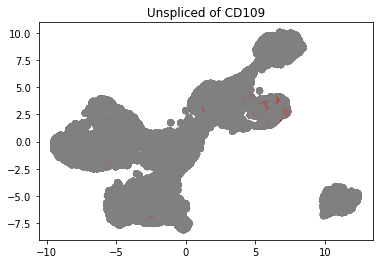

In [8]:
colorlist=["gray", "red"]
newcmp = LinearSegmentedColormap.from_list('testCmap', colors=colorlist, N=256)
for gene in plot_genes:
    plt.scatter(unsplicedDF['UMAP1'], unsplicedDF['UMAP2'], c = unsplicedDF[gene], cmap=newcmp)
    plt.title("Unspliced of " + gene)
    plt.savefig('/storage/holab/linxy/iPSC/veloAE/figures/velocitygenes_' + gene + '.png')

In [12]:
scv.pl.velocity(adata, plot_genes, vkey='stc_velocity', ncols=1, dpi = 900, save = '/home/linxy29/holab/iPSC/veloAE/figures/' + sample + '_' + 'velocitygenes.png')

saving figure to file /home/linxy29/holab/iPSC/veloAE/figures/day7_velocitygenes.png


## calculate pseudo time

In [15]:
scv.tl.velocity_graph(adata)
scv.tl.velocity_pseudotime(adata)

computing velocities
    finished (0:00:12) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/112 cores)


  0%|          | 0/9462 [00:00<?, ?cells/s]

    finished (0:01:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 4 regions of root cells and 1 region of end points .
    finished (0:00:24) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


In [16]:
adata.obs

,Clusters,_X,_Y,seurat_clusters,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,stc_velocity_self_transition,stc_velocity_length,stc_velocity_confidence,stc_velocity_confidence_transition,velocity_self_transition,root_cells,end_points,velocity_pseudotime
CellID,,,,,,,,,,,,,,,,
AAACCCAAGACATATG-1,1,-6.650407,22.455824,Axial/neuromesodermal progenitors,7667,2033,7667.0,8131.651367,0.090010,3.73,0.851435,0.188814,0.090010,0.251226,0.001613,0.310095
AAACCCAAGATAGCTA-1,10,41.323212,0.566137,Neurectoderm,6872,2261,6872.0,8075.890625,0.015205,3.66,0.874715,0.258804,0.015205,0.074129,0.002271,0.306215
AAACCCAAGGCCTGCT-1,2,-4.418742,8.546991,Notochord,15727,6397,15727.0,8096.488281,0.323979,6.45,0.886426,-0.049533,0.323979,0.403175,0.000011,0.337490
AAACCCAAGGTCACAG-1,0,16.002970,-0.544923,Lateral/paraxial mesoderm,5462,1766,5462.0,8032.063477,0.159883,6.07,0.855787,0.094012,0.159883,0.008740,0.001311,0.295479
AAACCCAAGTCAGCCC-1,12,1.904829,-36.297230,Lateral/paraxial mesoderm,18289,4823,18289.0,8077.847168,0.053571,4.25,0.906924,0.111202,0.053571,0.009839,0.000006,0.369371
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCATGCTGCG-1,5,-19.270281,29.124769,Neurectoderm,7358,1392,7358.0,8094.774902,0.193470,3.79,0.842650,0.074903,0.193470,0.004484,0.006078,0.310288
TTTGTTGGTACAGTTC-1,0,23.043644,-6.756123,Axial/neuromesodermal progenitors,24649,8595,24649.0,8114.276855,0.141281,3.62,0.957626,0.067406,0.141281,0.001113,0.000017,0.383644
TTTGTTGTCCGCAACG-1,0,28.649286,0.148411,Neurectoderm,11241,3369,11241.0,8100.538574,0.112279,5.19,0.913130,0.009141,0.112280,0.004448,0.004788,0.332444


In [17]:
mean_df = adata.obs.groupby('seurat_clusters')['velocity_pseudotime'].mean()
print(mean_df)
mean_df.to_csv('/storage/holab/linxy/iPSC/veloAE/' + sample + '_pseudotime_mean.csv', index=True, header=True)

seurat_clusters
Axial progenitors                    0.329461
Axial/neuromesodermal progenitors    0.329364
Endoderm                             0.320852
Homeostasis/stress                   0.423072
Lateral/paraxial mesoderm            0.311799
Neurectoderm                         0.315111
Neuromesodermal progenitors          0.321481
Notochord                            0.299191
Primitive streak                     0.338365
Name: velocity_pseudotime, dtype: float64


In [18]:
median_df = adata.obs.groupby('seurat_clusters')['velocity_pseudotime'].median()
print(median_df)
median_df.to_csv('/storage/holab/linxy/iPSC/veloAE/' + sample + '_pseudotime_median.csv', index=True, header=True)

seurat_clusters
Axial progenitors                    0.325781
Axial/neuromesodermal progenitors    0.323141
Endoderm                             0.317061
Homeostasis/stress                   0.334405
Lateral/paraxial mesoderm            0.313372
Neurectoderm                         0.314931
Neuromesodermal progenitors          0.320310
Notochord                            0.298294
Primitive streak                     0.333304
Name: velocity_pseudotime, dtype: float64
